In [4]:
import tensorflow 
import numpy as np 
import pandas as pd 
from collections import Counter
import random
import IPython
from IPython.display import Image, Audio
import music21
from music21 import *
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
import tensorflow.keras.backend as K
from tensorflow.keras.optimizers import Adamax
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline
import sys
import warnings
warnings.filterwarnings("ignore")
warnings.simplefilter("ignore")
np.random.seed(42)

In [1]:
!pip install pandas


[notice] A new release of pip is available: 23.2.1 -> 25.1.1
[notice] To update, run: pip install --upgrade pip


In [3]:
!pip install seaborn

  Obtaining dependency information for seaborn from https://files.pythonhosted.org/packages/83/11/00d3c3dfc25ad54e731d91449895a79e4bf2384dc3ac01809010ba88f6d5/seaborn-0.13.2-py3-none-any.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.9/294.9 kB 3.4 MB/s eta 0:00:00a 0:00:01

[notice] A new release of pip is available: 23.2.1 -> 25.1.1
[notice] To update, run: pip install --upgrade pip


In [5]:
import os

In [8]:
import os
from music21 import converter

filepath = "music/"
all_midis = []
for i in os.listdir(filepath):
    if i.endswith(".mid"):
        tr = filepath + i
        midi = converter.parse(tr)
        all_midis.append(midi)


In [9]:
def extract_notes(file):
    notes = []
    pick = None
    for j in file:
        songs = instrument.partitionByInstrument(j)
        for part in songs.parts:
            pick = part.recurse()
            for element in pick:
                if isinstance(element, note.Note):
                    notes.append(str(element.pitch))
                elif isinstance(element, chord.Chord):
                    notes.append(".".join(str(n) for n in element.normalOrder))

    return notes
#Getting the list of notes as Corpus
Corpus= extract_notes(all_midis)
print("Total notes in all the Chopin midis in the dataset:", len(Corpus))

Total notes in all the Chopin midis in the dataset: 57886


In [10]:
print("First fifty values in the Corpus:", Corpus[:50])

First fifty values in the Corpus: ['C3', 'C2', 'E-3', 'E-2', 'G#3', 'G#2', 'B-3', 'B-2', 'C4', 'C3', 'G#3', 'G#2', 'E-4', 'E-3', 'B-4', 'B-3', 'C5', 'C4', 'G#4', 'G#3', 'E-5', 'E-4', 'B-5', 'B-4', 'C6', 'C5', 'G5', 'G4', 'B-5', 'B-4', 'G#5', 'G#4', 'G5', 'G4', 'F#5', 'F#4', 'F#5', 'F#4', 'G5', 'G4', 'F#5', 'F#4', 'F5', 'F4', 'F#5', 'F#4', 'A5', 'A4', 'G5', 'G4']


In [14]:

def chords_n_notes(Snippet):
    Melody = []
    offset = 0 #Incremental
    for i in Snippet:
        #If it is chord
        if ("." in i or i.isdigit()):
            chord_notes = i.split(".") #Seperating the notes in chord
            notes = [] 
            for j in chord_notes:
                inst_note=int(j)
                note_snip = note.Note(inst_note)            
                notes.append(note_snip)
                chord_snip = chord.Chord(notes)
                chord_snip.offset = offset
                Melody.append(chord_snip)
        # pattern is a note
        else: 
            note_snip = note.Note(i)
            note_snip.offset = offset
            Melody.append(note_snip)
        # increase offset each iteration so that notes do not stack
        offset += 1
    Melody_midi = stream.Stream(Melody)   
    return Melody_midi

Melody_Snippet = chords_n_notes(Corpus[:100])
Melody_Snippet.write('midi', fp='my_melody.mid') 

'my_melody.mid'

In [15]:
!pip install midi2audio


  Obtaining dependency information for midi2audio from https://files.pythonhosted.org/packages/55/75/23618a687fc2391192c9d9ec8906a198a3f318f146388d3b96f779826d43/midi2audio-0.1.1-py2.py3-none-any.whl.metadata

[notice] A new release of pip is available: 23.2.1 -> 25.1.1
[notice] To update, run: pip install --upgrade pip


In [16]:
from midi2audio import FluidSynth

In [19]:
fs = FluidSynth()

In [21]:
fs.midi_to_audio('my_melody.mid', 'my_melody.wav')

FluidSynth runtime version 2.4.6
Copyright (C) 2000-2025 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'my_melody.wav'..


fluidsynth: error: fluid_is_soundfont(): fopen() failed: 'File does not exist.'
Parameter '/Users/pranjalimane/.fluidsynth/default_sound_font.sf2' not a SoundFont or MIDI file or error occurred identifying it.
fluidsynth: error: fluid_sfloader_load(): Failed to open '/opt/homebrew/Cellar/fluid-synth/2.4.6/share/soundfonts/default.sf2': File does not exist.
fluidsynth: error: Unable to open file '/opt/homebrew/Cellar/fluid-synth/2.4.6/share/soundfonts/default.sf2'
fluidsynth: error: Failed to load SoundFont "/opt/homebrew/Cellar/fluid-synth/2.4.6/share/soundfonts/default.sf2"


In [23]:
from midi2audio import FluidSynth

# Specify the path to your SoundFont
sf2_path = "GeneralUser-GS.sf2"

# Create the FluidSynth object with your SoundFont
fs = FluidSynth(sf2_path)

# Convert MIDI to WAV
fs.midi_to_audio('my_melody.mid', 'my_melody.wav')


FluidSynth runtime version 2.4.6
Copyright (C) 2000-2025 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'my_melody.wav'..


In [25]:
from IPython.display import Audio
Audio('my_melody.wav')

In [26]:
count_num = Counter(Corpus)
print("Total unique notes in the Corpus:", len(count_num))

Total unique notes in the Corpus: 397


In [27]:
Notes = list(count_num.keys())
Recurrence = list(count_num.values())
#Average recurrenc for a note in Corpus
def Average(lst):
    return sum(lst) / len(lst)
print("Average recurrenc for a note in Corpus:", Average(Recurrence))
print("Most frequent note in Corpus appeared:", max(Recurrence), "times")
print("Least frequent note in Corpus appeared:", min(Recurrence), "time")

Average recurrenc for a note in Corpus: 145.80856423173805
Most frequent note in Corpus appeared: 1627 times
Least frequent note in Corpus appeared: 1 time


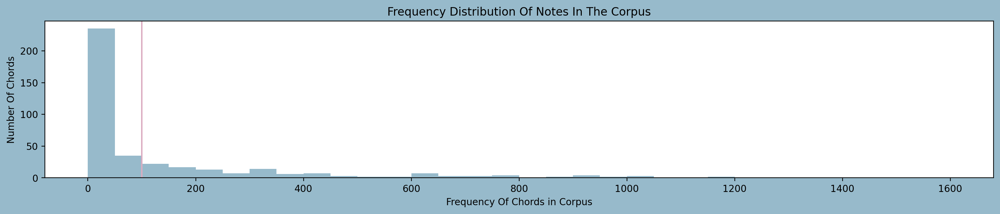

In [28]:
plt.figure(figsize=(18,3),facecolor="#97BACB")
bins = np.arange(0,(max(Recurrence)), 50) 
plt.hist(Recurrence, bins=bins, color="#97BACB")
plt.axvline(x=100,color="#DBACC1")
plt.title("Frequency Distribution Of Notes In The Corpus")
plt.xlabel("Frequency Of Chords in Corpus")
plt.ylabel("Number Of Chords")
plt.show()


In [29]:
rare_note = []
for index, (key, value) in enumerate(count_num.items()):
    if value < 100:
        m =  key
        rare_note.append(m)
        
print("Total number of notes that occur less than 100 times:", len(rare_note))

Total number of notes that occur less than 100 times: 270


In [30]:
for element in Corpus:
    if element in rare_note:
        Corpus.remove(element)

print("Length of Corpus after elemination the rare notes:", len(Corpus))

Length of Corpus after elemination the rare notes: 53737


In [31]:
symb = sorted(list(set(Corpus)))

L_corpus = len(Corpus) #length of corpus
L_symb = len(symb) #length of total unique characters

#Building dictionary to access the vocabulary from indices and vice versa
mapping = dict((c, i) for i, c in enumerate(symb))
reverse_mapping = dict((i, c) for i, c in enumerate(symb))

print("Total number of characters:", L_corpus)
print("Number of unique characters:", L_symb)

Total number of characters: 53737
Number of unique characters: 256


In [32]:
length = 40
features = []
targets = []
for i in range(0, L_corpus - length, 1):
    feature = Corpus[i:i + length]
    target = Corpus[i + length]
    features.append([mapping[j] for j in feature])
    targets.append(mapping[target])
    
    
L_datapoints = len(targets)
print("Total number of sequences in the Corpus:", L_datapoints)

Total number of sequences in the Corpus: 53697


In [33]:
X = (np.reshape(features, (L_datapoints, length, 1)))/ float(L_symb)
# one hot encode the output variable
y = tensorflow.keras.utils.to_categorical(targets) 

In [34]:
X_train, X_seed, y_train, y_seed = train_test_split(X, y, test_size=0.2, random_state=42)

In [35]:
model = Sequential()
#Adding layers
model.add(LSTM(512, input_shape=(X.shape[1], X.shape[2]), return_sequences=True))
model.add(Dropout(0.1))
model.add(LSTM(256))
model.add(Dense(256))
model.add(Dropout(0.1))
model.add(Dense(y.shape[1], activation='softmax'))
#Compiling the model for training  
opt = Adamax(learning_rate=0.01)
model.compile(loss='categorical_crossentropy', optimizer=opt)

In [36]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 40, 512)        │     1,052,672 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 40, 512)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 256)            │       787,456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 256)            │        65,792 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,971,712 (7.52 MB)

 Trainable params: 1,971,712 (7.52 MB)

 Non-trainable params: 0 (0.00 B)

In [37]:
history = model.fit(X_train, y_train, batch_size=256, epochs=200)

Epoch 1/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 75s 442ms/step - loss: 4.8869
Epoch 2/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 80s 478ms/step - loss: 4.5919
Epoch 3/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 77s 455ms/step - loss: 4.4605
Epoch 4/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 88s 523ms/step - loss: 4.4355
Epoch 5/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 96s 574ms/step - loss: 4.4163
Epoch 6/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 94s 559ms/step - loss: 4.4246
Epoch 7/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 99s 590ms/step - loss: 4.3898
Epoch 8/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 117s 697ms/step - loss: 4.3901
Epoch 9/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 99s 590ms/step - loss: 4.3886
Epoch 10/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 98s 584ms/step - loss: 4.3830
Epoch 11/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 98s 586ms/step - loss: 4.3665
Epoch 12/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 97s 579ms/step - loss: 4.3652
Epoch 13/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 101s 604ms/step - loss: 4.3428
Epoch 14/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 101s 602ms/step - loss: 4.331

In [38]:
def Malody_Generator(Note_Count, output_filename="generated_melody"):
    seed = X_seed[np.random.randint(0,len(X_seed)-1)]
    Music = ""
    Notes_Generated=[]
    for i in range(Note_Count):
        seed = seed.reshape(1,length,1)
        prediction = model.predict(seed, verbose=0)[0]
        prediction = np.log(prediction) / 1.0 #diversity
        exp_preds = np.exp(prediction)
        prediction = exp_preds / np.sum(exp_preds)
        index = np.argmax(prediction)
        index_N = index/ float(L_symb)   
        Notes_Generated.append(index)
        Music = [reverse_mapping[char] for char in Notes_Generated]
        seed = np.insert(seed[0],len(seed[0]),index_N)
        seed = seed[1:]
    
    # Convert to MIDI
    Melody = chords_n_notes(Music)
    Melody_midi = stream.Stream(Melody)   
    
    # Save as MIDI file
    midi_path = f"{output_filename}.mid"
    Melody_midi.write('midi', fp=midi_path)
    
    # Convert MIDI to WAV using your SoundFont
    from midi2audio import FluidSynth
    sf2_path = "GeneralUser-GS.sf2"
    fs = FluidSynth(sf2_path)
    
    wav_path = f"{output_filename}.wav"
    fs.midi_to_audio(midi_path, wav_path)
    
    print(f"Music saved as: {midi_path} and {wav_path}")
    
    return Music, Melody_midi, wav_path

# Generate music and automatically save as WAV
Music_notes, Melody, wav_file = Malody_Generator(100, "my_generated_song")

# Optional: Play the WAV file in Jupyter
from IPython.display import Audio
Audio(wav_file)


FluidSynth runtime version 2.4.6
Copyright (C) 2000-2025 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file 'my_generated_song.wav'..
Music saved as: my_generated_song.mid and my_generated_song.wav


[Text(0.5, 0, 'Epochs')]

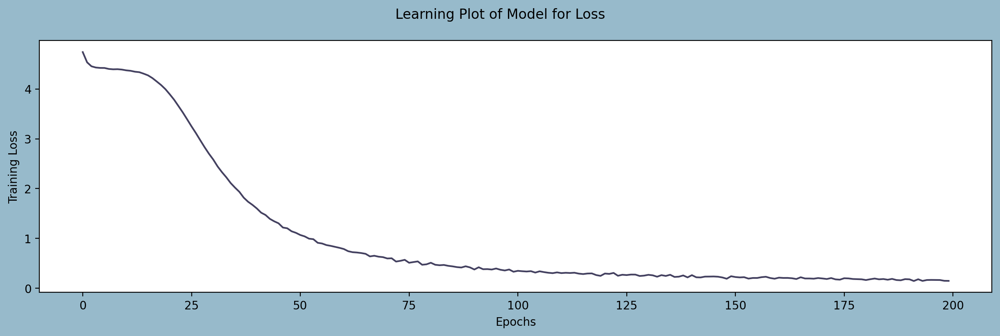

In [39]:
history_df = pd.DataFrame(history.history)
fig = plt.figure(figsize=(15,4), facecolor="#97BACB")
fig.suptitle("Learning Plot of Model for Loss")
pl=sns.lineplot(data=history_df["loss"],color="#444160")
pl.set(ylabel ="Training Loss")
pl.set(xlabel ="Epochs")